In [1]:
import spacy

In [2]:
nlp = spacy.load('en_core_web_sm')

In [3]:
from spacy.tokens import span

In [4]:
import numpy as np
import pandas as pd

In [5]:
df = pd.read_csv('cyberbullying_tweets.csv')

In [6]:
import nltk

In [7]:
df['tweet_text'] = df['tweet_text'].astype(str)

In [8]:
import re
import numpy as np
df.tweet_text=df.tweet_text.str.replace("@\w*", " ")

C:\Users\rafsa\AppData\Local\Temp\ipykernel_6836\261453544.py:3: FutureWarning: The default value of regex will change from True to False in a future version.
  df.tweet_text=df.tweet_text.str.replace("@\w*", " ")


In [9]:
df.tweet_text=df.tweet_text.str.replace("[^a-zA-Z]", " ")

C:\Users\rafsa\AppData\Local\Temp\ipykernel_6836\2636496267.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df.tweet_text=df.tweet_text.str.replace("[^a-zA-Z]", " ")


In [10]:
df.head()

,tweet_text,cyberbullying_type
0,In other words katandandre your food was cra...,not_cyberbullying
1,Why is aussietv so white MKR theblock ImA...,not_cyberbullying
2,a classy whore Or more red velvet cupcakes,not_cyberbullying
3,meh P thanks for the heads up but not to...,not_cyberbullying
4,This is an ISIS account pretending to be a K...,not_cyberbullying


In [11]:
nltk.word_tokenize(df['tweet_text'][0])

['In',
 'other',
 'words',
 'katandandre',
 'your',
 'food',
 'was',
 'crapilicious',
 'mkr']

In [12]:
from nltk.corpus import stopwords

In [13]:
stop_word = set(stopwords.words('English'))

In [14]:
df.apply(lambda x: x.astype(str).str.lower())

,tweet_text,cyberbullying_type
0,in other words katandandre your food was cra...,not_cyberbullying
1,why is aussietv so white mkr theblock ima...,not_cyberbullying
2,a classy whore or more red velvet cupcakes,not_cyberbullying
3,meh p thanks for the heads up but not to...,not_cyberbullying
4,this is an isis account pretending to be a k...,not_cyberbullying
...,...,...
47687,black ppl aren t expected to do anything depe...,ethnicity
47688,turner did not withhold his disappointment tu...,ethnicity
47689,i swear to god this dumb nigger bitch i have...,ethnicity
47690,yea fuck you rt if youre a nigger fucking u...,ethnicity


In [15]:
df['tweet_text'].str.split()

0        [In, other, words, katandandre, your, food, wa...
1        [Why, is, aussietv, so, white, MKR, theblock, ...
2        [a, classy, whore, Or, more, red, velvet, cupc...
3        [meh, P, thanks, for, the, heads, up, but, not...
4        [This, is, an, ISIS, account, pretending, to, ...
                               ...                        
47687    [Black, ppl, aren, t, expected, to, do, anythi...
47688    [Turner, did, not, withhold, his, disappointme...
47689    [I, swear, to, God, This, dumb, nigger, bitch,...
47690    [Yea, fuck, you, RT, IF, YOURE, A, NIGGER, FUC...
47691    [Bro, U, gotta, chill, RT, Dog, FUCK, KP, that...
Name: tweet_text, Length: 47692, dtype: object

In [16]:
df['tweettext'] = df['tweet_text'].apply(lambda x: ' '.join([item for item in x.split() if item not in stop_word]))

In [17]:
df.dropna()

,tweet_text,cyberbullying_type,tweettext
0,In other words katandandre your food was cra...,not_cyberbullying,In words katandandre food crapilicious mkr
1,Why is aussietv so white MKR theblock ImA...,not_cyberbullying,Why aussietv white MKR theblock ImACelebrityAU...
2,a classy whore Or more red velvet cupcakes,not_cyberbullying,classy whore Or red velvet cupcakes
3,meh P thanks for the heads up but not to...,not_cyberbullying,meh P thanks heads concerned another angry dud...
4,This is an ISIS account pretending to be a K...,not_cyberbullying,This ISIS account pretending Kurdish account L...
...,...,...,...
47687,Black ppl aren t expected to do anything depe...,ethnicity,Black ppl expected anything depended anything ...
47688,Turner did not withhold his disappointment Tu...,ethnicity,Turner withhold disappointment Turner called c...
47689,I swear to God This dumb nigger bitch I have...,ethnicity,I swear God This dumb nigger bitch I got bleac...
47690,Yea fuck you RT IF YOURE A NIGGER FUCKING U...,ethnicity,Yea fuck RT IF YOURE A NIGGER FUCKING UNFOLLOW...


In [18]:
df.head()

,tweet_text,cyberbullying_type,tweettext
0,In other words katandandre your food was cra...,not_cyberbullying,In words katandandre food crapilicious mkr
1,Why is aussietv so white MKR theblock ImA...,not_cyberbullying,Why aussietv white MKR theblock ImACelebrityAU...
2,a classy whore Or more red velvet cupcakes,not_cyberbullying,classy whore Or red velvet cupcakes
3,meh P thanks for the heads up but not to...,not_cyberbullying,meh P thanks heads concerned another angry dud...
4,This is an ISIS account pretending to be a K...,not_cyberbullying,This ISIS account pretending Kurdish account L...


In [19]:
del df['tweet_text']

In [20]:
del df ['cyberbullying_type']

In [21]:
df.head()

,tweettext
0,In words katandandre food crapilicious mkr
1,Why aussietv white MKR theblock ImACelebrityAU...
2,classy whore Or red velvet cupcakes
3,meh P thanks heads concerned another angry dud...
4,This ISIS account pretending Kurdish account L...


In [22]:
from nltk.stem import PorterStemmer
from nltk.corpus import stopwords
import string
from nltk.tokenize import TweetTokenizer
import re
import nltk
from nltk.stem import WordNetLemmatizer
def decontract(text):
    text = re.sub(r"won\'t", "will not", text)
    text = re.sub(r"can\'t", "can not", text)
    text = re.sub(r"n\'t", " not", text)
    text = re.sub(r"\'re", " are", text)
    text = re.sub(r"\'s", " is", text)
    text = re.sub(r"\'d", " would", text)
    text = re.sub(r"\'ll", " will", text)
    text = re.sub(r"\'t", " not", text)
    text = re.sub(r"\'ve", " have", text)
    text = re.sub(r"\'m", " am", text)
    return text
lemmatizer = WordNetLemmatizer()
def process_text(text):

    stemmer = PorterStemmer()
    stopwords_english = stopwords.words('english')
    # remove stock market tickers like $GE
    #text = re.sub(r'\$\w*', '', text)
    # remove old style retweet text "RT"
    #text = re.sub(r'^RT[\s]+', '', text)
    # remove hyperlinks
    text = re.sub(r'https?:\/\/.*[\r\n]*', '', text)
    # remove hashtags
    # only removing the hash # sign from the word
    text = re.sub(r'#', '', text)
    text = str(re.sub("\S*\d\S*", "", text).strip()) 
    text=decontract(text)
    #df.tweettext=df.tweettext.str.replace("@\w*", " ")
    #df.tweettext=df.tweettext.str.replace("[^a-zA-Z]", " ")
    # tokenize texts
    tokenizer = TweetTokenizer(preserve_case=False, strip_handles=True,
                              reduce_len=True)
    tokens = tokenizer.tokenize(text)
    #stop_word = set(stopwords.words('English'))
    #df.apply(lambda x: x.astype(str).str.lower())
    #df['tweettext'] = df['tweettext'].apply(lambda x: ' '.join([item for item in x.split() if item not in stop_word]))
    texts_clean = []
    for word in tokens:
        if (word not in stopwords_english and  # remove stopwords
                word not in string.punctuation+'...'):  # remove punctuation
             
            stem_word = lemmatizer.lemmatize(word,"v")  # Lemmatizing word
            texts_clean.append(stem_word)

    return " ".join(texts_clean)

df['tweettext']=df['tweettext'].apply(lambda x: process_text(str(x)))
df.head()


,tweettext
0,word katandandre food crapilicious mkr
1,aussietv white mkr theblock imacelebrityau tod...
2,classy whore red velvet cupcakes
3,meh p thank head concern another angry dude tw...
4,isis account pretend kurdish account like isla...


In [23]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
sid = SentimentIntensityAnalyzer()

In [24]:
df['scores']= df['tweettext'].apply(lambda tweettext: sid.polarity_scores(tweettext))

In [25]:
df.head()

,tweettext,scores
0,word katandandre food crapilicious mkr,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
1,aussietv white mkr theblock imacelebrityau tod...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
2,classy whore red velvet cupcakes,"{'neg': 0.422, 'neu': 0.294, 'pos': 0.284, 'co..."
3,meh p thank head concern another angry dude tw...,"{'neg': 0.38, 'neu': 0.413, 'pos': 0.207, 'com..."
4,isis account pretend kurdish account like isla...,"{'neg': 0.141, 'neu': 0.606, 'pos': 0.253, 'co..."


In [26]:
df['compound'] = df['scores'].apply(lambda score_dict: score_dict['compound'])
df['cyberbullying_possibilities'] = df['compound'].apply(lambda c: 'pos' if c>=0 else 'neg')
df.head()

,tweettext,scores,compound,cyberbullying_possibilities
0,word katandandre food crapilicious mkr,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.0000,pos
1,aussietv white mkr theblock imacelebrityau tod...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.0000,pos
2,classy whore red velvet cupcakes,"{'neg': 0.422, 'neu': 0.294, 'pos': 0.284, 'co...",-0.3400,neg
3,meh p thank head concern another angry dude tw...,"{'neg': 0.38, 'neu': 0.413, 'pos': 0.207, 'com...",-0.2732,neg
4,isis account pretend kurdish account like isla...,"{'neg': 0.141, 'neu': 0.606, 'pos': 0.253, 'co...",0.2732,pos


In [27]:
df.to_csv('cyberbullyingtweets.csv')

In [28]:
df = pd.read_csv('cyberbullying_tweets.csv')

In [27]:
df.head()

,tweettext,scores,compound,cyberbullying_possibilities
0,word katandandre food crapilicious mkr,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.0000,pos
1,aussietv white mkr theblock imacelebrityau tod...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.0000,pos
2,classy whore red velvet cupcakes,"{'neg': 0.422, 'neu': 0.294, 'pos': 0.284, 'co...",-0.3400,neg
3,meh p thank head concern another angry dude tw...,"{'neg': 0.38, 'neu': 0.413, 'pos': 0.207, 'com...",-0.2732,neg
4,isis account pretend kurdish account like isla...,"{'neg': 0.141, 'neu': 0.606, 'pos': 0.253, 'co...",0.2732,pos


In [28]:
from sklearn.model_selection import train_test_split 
x = df['tweettext']
y=df['cyberbullying_possibilities']
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.33, random_state=42)

In [29]:
import lime
import sklearn
import numpy as np
from __future__ import print_function
import sklearn
import sklearn.ensemble
import sklearn.metrics
from sklearn.ensemble import BaggingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import ExtraTreesClassifier

In [30]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer()
x_train_tfidf = vectorizer.fit_transform(x_train)
x_test_tfidf= vectorizer.transform(x_test)

In [31]:
df.to_csv('cyberbullyingtweets.csv')

In [32]:
rf1 = sklearn.ensemble.RandomForestClassifier(n_estimators=500)

In [33]:
rf1.fit(x_train_tfidf, y_train)

RandomForestClassifier(n_estimators=500)

In [34]:
predictions = rf1.predict(x_test_tfidf)

In [35]:
from sklearn import metrics 
import matplotlib.pyplot as plt
from sklearn.metrics import plot_confusion_matrix
print(metrics.confusion_matrix(y_test, predictions))
#plot_confusion_matrix(rf1,x_test,y_test)
#plt.show()

[[9152  589]
 [1468 4530]]


In [36]:
print(metrics.classification_report(y_test,predictions))

              precision    recall  f1-score   support

         neg       0.86      0.94      0.90      9741
         pos       0.88      0.76      0.81      5998

    accuracy                           0.87     15739
   macro avg       0.87      0.85      0.86     15739
weighted avg       0.87      0.87      0.87     15739



In [37]:
print(metrics.accuracy_score(y_test, predictions))

0.8693055467310502


In [38]:
import lime
import sklearn
import numpy as np
from __future__ import print_function
import sklearn
import sklearn.ensemble
import sklearn.metrics
from sklearn.ensemble import BaggingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import ExtraTreesClassifier


In [39]:
from lime import lime_text
from sklearn.pipeline import make_pipeline

In [40]:
c = make_pipeline(vectorizer, rf1)

In [41]:
from lime.lime_text import LimeTextExplainer
class_names = ['cyberbullying', 'noncyberbullying']
#class_names2 = ['Age', 'Religion', 'Gender', 'Race']
explainer = LimeTextExplainer(class_names=class_names)
#@explainer2 = LimeTextExplainer(class_names=class_names2)

In [42]:
print('Probability(cyberbullying) =',
c.predict_proba([df.tweettext[40179]])[0,0])

Probability(cyberbullying) = 1.0


In [43]:
exp = explainer.explain_instance(df.tweettext[10836], c.predict_proba,num_features=10)
#exp2 = explainer2.explain_instance(df.tweettext[40179], c.predict_proba, num_features=10)

In [44]:
exp.as_list()

[('hate', -0.3139032397727301),
 ('block', -0.29583918418173427),
 ('thank', 0.13934234951260155),
 ('unfollow', -0.06744122136554977),
 ('plz', -0.024946358055206452),
 ('feminists', -0.016658013747833048),
 ('follow', -0.006975290412179937),
 ('get', -0.004056664316948663)]

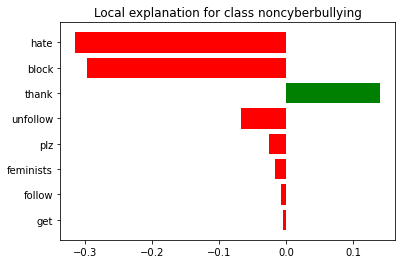

In [45]:
fig = exp.as_pyplot_figure()

In [46]:
print('Probability(cyberbullying) =',
c.predict_proba([df.tweettext[40179]])[0,0])
exp.show_in_notebook(text=True)
#exp2.show_in_notebook(text=True)

Probability(cyberbullying) = 1.0


In [47]:
df.to_csv('cyberbullying_tweets2.csv')

In [48]:
rf2=BaggingClassifier(KNeighborsClassifier(), n_estimators=500, max_samples=0.5, max_features=0.5)

In [49]:
rf2.fit(x_train_tfidf, y_train)

BaggingClassifier(base_estimator=KNeighborsClassifier(), max_features=0.5,
                  max_samples=0.5, n_estimators=500)

In [50]:
predictions = rf2.predict(x_test_tfidf)

In [51]:
print(metrics.confusion_matrix(y_test, predictions))

[[7286 2455]
 [1115 4883]]


In [52]:
print(metrics.classification_report(y_test,predictions))

              precision    recall  f1-score   support

         neg       0.87      0.75      0.80      9741
         pos       0.67      0.81      0.73      5998

    accuracy                           0.77     15739
   macro avg       0.77      0.78      0.77     15739
weighted avg       0.79      0.77      0.78     15739



In [53]:
print(metrics.accuracy_score(y_test, predictions))

0.7731749158142195


In [54]:
c1 = make_pipeline(vectorizer, rf2)

In [55]:
exp2 = explainer.explain_instance(df.tweettext[17192], c1.predict_proba,num_features=10)

In [56]:
exp2.as_list()

[('racist', -0.09500320211457375),
 ('arabs', 0.0646850869416058),
 ('idiot', -0.041491671839567215),
 ('palestinians', 0.02410941797688821),
 ('save', 0.022469860111332205),
 ('energy', 0.020575563783339138),
 ('tf', 0.01678300424033067),
 ('general', 0.01571684412745816),
 ('muslims', -0.010140521395242432),
 ('people', -0.009513264378704447)]

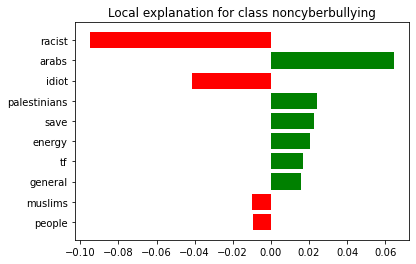

In [57]:
fig = exp2.as_pyplot_figure()

In [58]:
exp2.show_in_notebook(text=True)

In [59]:
rf3= GradientBoostingClassifier(random_state=1, n_estimators=500)

In [60]:
rf3.fit(x_train_tfidf, y_train)

GradientBoostingClassifier(n_estimators=500, random_state=1)

In [61]:
predictions = rf3.predict(x_test_tfidf)

In [62]:
print(metrics.confusion_matrix(y_test, predictions))

[[8587 1154]
 [ 963 5035]]


In [63]:
print(metrics.classification_report(y_test,predictions))

              precision    recall  f1-score   support

         neg       0.90      0.88      0.89      9741
         pos       0.81      0.84      0.83      5998

    accuracy                           0.87     15739
   macro avg       0.86      0.86      0.86     15739
weighted avg       0.87      0.87      0.87     15739



In [64]:
print(metrics.accuracy_score(y_test, predictions))

0.8654933604422136


In [65]:
c2 = make_pipeline(vectorizer, rf3)

In [66]:
exp3 = explainer.explain_instance(df.tweettext[17192], c2.predict_proba,num_features=10)

[('idiot', -0.3399219360886276),
 ('racist', -0.16653130203946492),
 ('save', 0.06394308129581593),
 ('muslims', -0.030614572429622417),
 ('arabs', 0.02479398040070048),
 ('black', -0.024181152450534735),
 ('tf', 0.02024861658460454),
 ('palestinians', 0.011254774171085722),
 ('energy', 0.008363321997187997),
 ('people', -0.006471801309453651)]

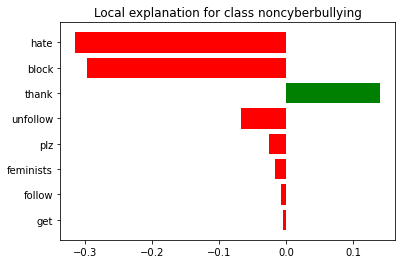

In [67]:
fig = exp.as_pyplot_figure()
exp3.as_list()

In [68]:
exp3.show_in_notebook(text=True)

In [69]:
rf4 = ExtraTreesClassifier(n_estimators=500, random_state=1)

In [70]:
rf4.fit(x_train_tfidf, y_train)

ExtraTreesClassifier(n_estimators=500, random_state=1)

In [71]:
predictions = rf4.predict(x_test_tfidf)
from sklearn import metrics 
print(metrics.confusion_matrix(y_test, predictions))

[[9320  421]
 [1591 4407]]


In [72]:
print(metrics.classification_report(y_test,predictions))

              precision    recall  f1-score   support

         neg       0.85      0.96      0.90      9741
         pos       0.91      0.73      0.81      5998

    accuracy                           0.87     15739
   macro avg       0.88      0.85      0.86     15739
weighted avg       0.88      0.87      0.87     15739



In [73]:
print(metrics.accuracy_score(y_test, predictions))

0.8721646864476778


In [74]:
c3 = make_pipeline(vectorizer, rf4)

In [75]:
exp4 = explainer.explain_instance(df.tweettext[17192], c3.predict_proba,num_features=10)

[('racist', -0.17178952605176295),
 ('idiot', -0.09426000520938914),
 ('save', 0.08689707075107149),
 ('muslims', -0.03530027997461046),
 ('embarrass', -0.026046716667209126),
 ('black', -0.022536675270729015),
 ('energy', 0.01556348659713768),
 ('need', 0.009109085156215302),
 ('us', 0.00857255372405515),
 ('palestinians', -0.00761169652540284)]

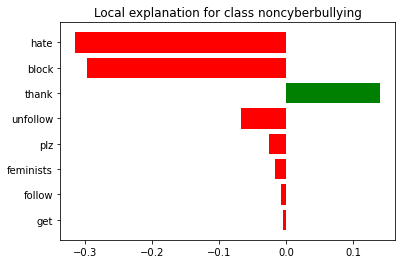

In [76]:
fig = exp.as_pyplot_figure()
exp4.as_list()

In [77]:
exp4.show_in_notebook(text=True)

In [78]:
from sklearn.svm import SVC
from sklearn import svm

In [79]:
rf5 = svm.SVC(kernel='linear', C=1, probability=True)

In [80]:
rf5.fit(x_train_tfidf, y_train)

SVC(C=1, kernel='linear', probability=True)

In [81]:
predictions = rf5.predict(x_test_tfidf)
from sklearn import metrics 
print(metrics.confusion_matrix(y_test, predictions))

[[9071  670]
 [ 641 5357]]


In [82]:
print(metrics.classification_report(y_test,predictions))

              precision    recall  f1-score   support

         neg       0.93      0.93      0.93      9741
         pos       0.89      0.89      0.89      5998

    accuracy                           0.92     15739
   macro avg       0.91      0.91      0.91     15739
weighted avg       0.92      0.92      0.92     15739



In [83]:
print(metrics.accuracy_score(y_test, predictions))

0.9167037295889192


In [84]:
c4 = make_pipeline(vectorizer, rf5)

In [85]:
exp5 = explainer.explain_instance(df.tweettext[11874], c4.predict_proba,num_features=10)

[('piss', -0.4903403729270183),
 ('dhumjc', 0.09324437881309226),
 ('qho', 0.09122593795158558),
 ('yesallmen', 0.059783550437554185),
 ('http', 0.05783332663765085),
 ('probably', 0.0535152299453389),
 ('gonna', -0.046009496182515326),
 ('feminists', 0.028355246321401156),
 ('rt', 0.016518520257991946),
 ('co', -0.012596441818802444)]

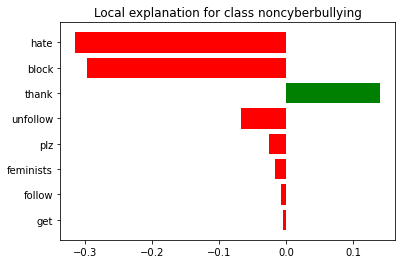

In [86]:
fig = exp.as_pyplot_figure()
exp5.as_list()

In [87]:
exp5.show_in_notebook(text=True)

In [88]:
df2 = pd.read_csv('cyberbullyingtweet_12.csv')

In [89]:
df2.head()

,Unnamed: 0,tweet_text,cyberbullying_type,tweettext
0,0,In other words katandandre your food was cra...,not_cyberbullying,word katandandre food crapilicious mkr
1,1,Why is aussietv so white MKR theblock ImA...,not_cyberbullying,aussietv white mkr theblock imacelebrityau tod...
2,2,a classy whore Or more red velvet cupcakes,not_cyberbullying,classy whore red velvet cupcakes
3,3,meh P thanks for the heads up but not to...,not_cyberbullying,meh p thank head concern another angry dude tw...
4,4,This is an ISIS account pretending to be a K...,not_cyberbullying,isis account pretend kurdish account like isla...


In [90]:
from sklearn.model_selection import train_test_split 
x1 = df2['tweettext']
y1=df2['cyberbullying_type']
x1_train, x1_test, y1_train, y1_test = train_test_split(x1,y1, test_size=0.33, random_state=42)

In [91]:
exp.show_in_notebook(text=True)

In [92]:
df2 =pd.read_csv('cyberbullying_tweets.csv')

In [93]:
df2['tweet_text'] = df2['tweet_text'].astype(str)

In [94]:
import re
import numpy as np
df2.tweet_text=df2.tweet_text.str.replace("@\w*", " ")

C:\Users\rafsa\AppData\Local\Temp\ipykernel_6836\2947846495.py:3: FutureWarning: The default value of regex will change from True to False in a future version.
  df2.tweet_text=df2.tweet_text.str.replace("@\w*", " ")


In [95]:
df2.tweet_text=df2.tweet_text.str.replace("[^a-zA-Z]", " ")

C:\Users\rafsa\AppData\Local\Temp\ipykernel_6836\3305281295.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df2.tweet_text=df2.tweet_text.str.replace("[^a-zA-Z]", " ")


In [96]:
nltk.word_tokenize(df2['tweet_text'][0])

['In',
 'other',
 'words',
 'katandandre',
 'your',
 'food',
 'was',
 'crapilicious',
 'mkr']

In [97]:
stop_word = set(stopwords.words('English'))

In [98]:
df2.apply(lambda x: x.astype(str).str.lower())

,tweet_text,cyberbullying_type
0,in other words katandandre your food was cra...,not_cyberbullying
1,why is aussietv so white mkr theblock ima...,not_cyberbullying
2,a classy whore or more red velvet cupcakes,not_cyberbullying
3,meh p thanks for the heads up but not to...,not_cyberbullying
4,this is an isis account pretending to be a k...,not_cyberbullying
...,...,...
47687,black ppl aren t expected to do anything depe...,ethnicity
47688,turner did not withhold his disappointment tu...,ethnicity
47689,i swear to god this dumb nigger bitch i have...,ethnicity
47690,yea fuck you rt if youre a nigger fucking u...,ethnicity


In [99]:
df2['tweet_text'].str.split()

0        [In, other, words, katandandre, your, food, wa...
1        [Why, is, aussietv, so, white, MKR, theblock, ...
2        [a, classy, whore, Or, more, red, velvet, cupc...
3        [meh, P, thanks, for, the, heads, up, but, not...
4        [This, is, an, ISIS, account, pretending, to, ...
                               ...                        
47687    [Black, ppl, aren, t, expected, to, do, anythi...
47688    [Turner, did, not, withhold, his, disappointme...
47689    [I, swear, to, God, This, dumb, nigger, bitch,...
47690    [Yea, fuck, you, RT, IF, YOURE, A, NIGGER, FUC...
47691    [Bro, U, gotta, chill, RT, Dog, FUCK, KP, that...
Name: tweet_text, Length: 47692, dtype: object

In [100]:
df2['tweettext'] = df2['tweet_text'].apply(lambda x: ' '.join([item for item in x.split() if item not in stop_word]))


In [101]:
df2.dropna()

,tweet_text,cyberbullying_type,tweettext
0,In other words katandandre your food was cra...,not_cyberbullying,In words katandandre food crapilicious mkr
1,Why is aussietv so white MKR theblock ImA...,not_cyberbullying,Why aussietv white MKR theblock ImACelebrityAU...
2,a classy whore Or more red velvet cupcakes,not_cyberbullying,classy whore Or red velvet cupcakes
3,meh P thanks for the heads up but not to...,not_cyberbullying,meh P thanks heads concerned another angry dud...
4,This is an ISIS account pretending to be a K...,not_cyberbullying,This ISIS account pretending Kurdish account L...
...,...,...,...
47687,Black ppl aren t expected to do anything depe...,ethnicity,Black ppl expected anything depended anything ...
47688,Turner did not withhold his disappointment Tu...,ethnicity,Turner withhold disappointment Turner called c...
47689,I swear to God This dumb nigger bitch I have...,ethnicity,I swear God This dumb nigger bitch I got bleac...
47690,Yea fuck you RT IF YOURE A NIGGER FUCKING U...,ethnicity,Yea fuck RT IF YOURE A NIGGER FUCKING UNFOLLOW...


In [102]:
from nltk.stem import PorterStemmer
from nltk.corpus import stopwords
import string
from nltk.tokenize import TweetTokenizer
import re
import nltk
from nltk.stem import WordNetLemmatizer
def decontract(text):
    text = re.sub(r"won\'t", "will not", text)
    text = re.sub(r"can\'t", "can not", text)
    text = re.sub(r"n\'t", " not", text)
    text = re.sub(r"\'re", " are", text)
    text = re.sub(r"\'s", " is", text)
    text = re.sub(r"\'d", " would", text)
    text = re.sub(r"\'ll", " will", text)
    text = re.sub(r"\'t", " not", text)
    text = re.sub(r"\'ve", " have", text)
    text = re.sub(r"\'m", " am", text)
    return text
lemmatizer = WordNetLemmatizer()
def process_text(text):

    stemmer = PorterStemmer()
    stopwords_english = stopwords.words('english')
    # remove stock market tickers like $GE
    #text = re.sub(r'\$\w*', '', text)
    # remove old style retweet text "RT"
    #text = re.sub(r'^RT[\s]+', '', text)
    # remove hyperlinks
    text = re.sub(r'https?:\/\/.*[\r\n]*', '', text)
    # remove hashtags
    # only removing the hash # sign from the word
    text = re.sub(r'#', '', text)
    text = str(re.sub("\S*\d\S*", "", text).strip()) 
    text=decontract(text)
    #df.tweettext=df.tweettext.str.replace("@\w*", " ")
    #df.tweettext=df.tweettext.str.replace("[^a-zA-Z]", " ")
    # tokenize texts
    tokenizer = TweetTokenizer(preserve_case=False, strip_handles=True,
                              reduce_len=True)
    tokens = tokenizer.tokenize(text)
    #stop_word = set(stopwords.words('English'))
    #df.apply(lambda x: x.astype(str).str.lower())
    #df['tweettext'] = df['tweettext'].apply(lambda x: ' '.join([item for item in x.split() if item not in stop_word]))
    texts_clean = []
    for word in tokens:
        if (word not in stopwords_english and  # remove stopwords
                word not in string.punctuation+'...'):  # remove punctuation
             
            stem_word = lemmatizer.lemmatize(word,"v")  # Lemmatizing word
            texts_clean.append(stem_word)

    return " ".join(texts_clean)

df2['tweettext']=df2['tweettext'].apply(lambda x: process_text(str(x)))
df2.head()

,tweet_text,cyberbullying_type,tweettext
0,In other words katandandre your food was cra...,not_cyberbullying,word katandandre food crapilicious mkr
1,Why is aussietv so white MKR theblock ImA...,not_cyberbullying,aussietv white mkr theblock imacelebrityau tod...
2,a classy whore Or more red velvet cupcakes,not_cyberbullying,classy whore red velvet cupcakes
3,meh P thanks for the heads up but not to...,not_cyberbullying,meh p thank head concern another angry dude tw...
4,This is an ISIS account pretending to be a K...,not_cyberbullying,isis account pretend kurdish account like isla...


In [103]:
from sklearn.model_selection import train_test_split 
x1 = df2['tweettext']
y1=df2['cyberbullying_type']
x1_train, x1_test, y1_train, y1_test = train_test_split(x1,y1, test_size=0.33, random_state=42)

In [104]:
vectorizer1 = TfidfVectorizer()
x_train_tfidf1 = vectorizer1.fit_transform(x1_train)
x_test_tfidf1= vectorizer1.transform(x1_test)

In [105]:
rf11 = sklearn.ensemble.RandomForestClassifier(n_estimators=500)

In [106]:
rf11.fit(x_train_tfidf1, y1_train)

RandomForestClassifier(n_estimators=500)

In [107]:
predictions1 = rf11.predict(x_test_tfidf1)

In [108]:
print(metrics.confusion_matrix(y1_test, predictions1))

[[2540    1    5   22   29    1]
 [   3 2600    3   11   26    3]
 [   4    6 2159  164  248    3]
 [  40    6   90 1325 1164   98]
 [  13    6  123  605 1844   14]
 [   0    5    7   54   53 2464]]


In [109]:
print(metrics.classification_report(y1_test,predictions1))

                     precision    recall  f1-score   support

                age       0.98      0.98      0.98      2598
          ethnicity       0.99      0.98      0.99      2646
             gender       0.90      0.84      0.87      2584
  not_cyberbullying       0.61      0.49      0.54      2723
other_cyberbullying       0.55      0.71      0.62      2605
           religion       0.95      0.95      0.95      2583

           accuracy                           0.82     15739
          macro avg       0.83      0.82      0.82     15739
       weighted avg       0.83      0.82      0.82     15739



In [110]:
exp.show_in_notebook(text=True)

In [111]:
c11 = make_pipeline(vectorizer1, rf11)
#c=make_pipeline(vectorizer,rf1)

In [112]:
#exp = explainer.explain_instance(df.tweettext[15013], c.predict_proba,num_features=10)
exp6 = explainer.explain_instance(df.tweettext[22144], c11.predict_proba,num_features=10)

In [113]:
exp2.show_in_notebook(text=True)

In [114]:
class_names2 = ['age', 'ethnicity', 'gender', 'not_cyberbullying', 'other_cyberbullying', 'religion']
#class_names2 = ['Age', 'Religion', 'Gender', 'Race']
explainer1= LimeTextExplainer(class_names=class_names2)

In [115]:
exp = explainer.explain_instance(df.tweettext[39867], c.predict_proba,num_features=10)
exp6 = explainer1.explain_instance(df2.tweettext[39867], c11.predict_proba,num_features=10)

In [116]:
exp.show_in_notebook(text=True)
exp6.show_in_notebook(text=True)

In [117]:
#rf12=BaggingClassifier(KNeighborsClassifier(), n_estimators=500, max_samples=0.5, max_features=0.5)

In [118]:
#rf12.fit(x_train_tfidf1, y1_train)

In [119]:
#predictions1 = rf12.predict(x_test_tfidf1)

In [120]:
rf13= GradientBoostingClassifier(random_state=1, n_estimators=500)

In [121]:
rf13.fit(x_train_tfidf1, y1_train)

GradientBoostingClassifier(n_estimators=500, random_state=1)

In [122]:
predictions3 = rf13.predict(x_test_tfidf1)

In [123]:
print(metrics.confusion_matrix(y1_test, predictions3))

[[2521    0    6   42   28    1]
 [   0 2589    8    7   39    3]
 [   1    0 2155  132  292    4]
 [  24    2   88 1266 1273   70]
 [  10    4  100  326 2164    1]
 [   0    3    8   59   72 2441]]


In [124]:
print(metrics.classification_report(y1_test,predictions3))

                     precision    recall  f1-score   support

                age       0.99      0.97      0.98      2598
          ethnicity       1.00      0.98      0.99      2646
             gender       0.91      0.83      0.87      2584
  not_cyberbullying       0.69      0.46      0.56      2723
other_cyberbullying       0.56      0.83      0.67      2605
           religion       0.97      0.95      0.96      2583

           accuracy                           0.83     15739
          macro avg       0.85      0.84      0.84     15739
       weighted avg       0.85      0.83      0.83     15739



In [125]:
c13 = make_pipeline(vectorizer1, rf13)


In [126]:
exp8 = explainer1.explain_instance(df2.tweettext[17192], c13.predict_proba,num_features=10)

In [127]:
exp3.show_in_notebook(text=True)
exp8.show_in_notebook(text=True)

In [128]:
rf14 = ExtraTreesClassifier(n_estimators=500, random_state=1)

In [129]:
rf14.fit(x_train_tfidf1, y1_train)

ExtraTreesClassifier(n_estimators=500, random_state=1)

In [130]:
predictions4 = rf14.predict(x_test_tfidf1)

In [131]:
print(metrics.confusion_matrix(y1_test, predictions4))

[[2553    2    5   14   22    2]
 [   2 2599    4    8   24    9]
 [   8    7 2188  154  218    9]
 [  59   12   96 1358 1092  106]
 [  31   11  132  605 1809   17]
 [   0    5    6   51   39 2482]]


In [132]:
print(metrics.classification_report(y1_test,predictions4))

                     precision    recall  f1-score   support

                age       0.96      0.98      0.97      2598
          ethnicity       0.99      0.98      0.98      2646
             gender       0.90      0.85      0.87      2584
  not_cyberbullying       0.62      0.50      0.55      2723
other_cyberbullying       0.56      0.69      0.62      2605
           religion       0.95      0.96      0.95      2583

           accuracy                           0.83     15739
          macro avg       0.83      0.83      0.83     15739
       weighted avg       0.83      0.83      0.82     15739



In [133]:
c14 = make_pipeline(vectorizer1, rf14)


In [134]:
exp9 = explainer1.explain_instance(df2.tweettext[17192], c14.predict_proba,num_features=10)

In [135]:
exp4.show_in_notebook(text=True)
exp9.show_in_notebook(text=True)

In [136]:
rf15 = svm.SVC(kernel='linear', C=1, probability=True)

In [137]:
rf15.fit(x_train_tfidf1, y1_train)

SVC(C=1, kernel='linear', probability=True)

In [138]:
predictions5 = rf15.predict(x_test_tfidf1)

In [139]:
print(metrics.confusion_matrix(y1_test, predictions5))

[[2540    2    4   23   28    1]
 [   6 2586    4   14   31    5]
 [   6   11 2189  182  190    6]
 [ 106   24  103 1415  988   87]
 [  25   25  119  604 1824    8]
 [   2   11    9   75   37 2449]]


In [140]:
print(metrics.classification_report(y1_test,predictions5))

                     precision    recall  f1-score   support

                age       0.95      0.98      0.96      2598
          ethnicity       0.97      0.98      0.97      2646
             gender       0.90      0.85      0.87      2584
  not_cyberbullying       0.61      0.52      0.56      2723
other_cyberbullying       0.59      0.70      0.64      2605
           religion       0.96      0.95      0.95      2583

           accuracy                           0.83     15739
          macro avg       0.83      0.83      0.83     15739
       weighted avg       0.83      0.83      0.83     15739



In [141]:
c15 = make_pipeline(vectorizer1, rf15)


In [142]:
exp10 = explainer1.explain_instance(df2.tweettext[11874], c15.predict_proba,num_features=10)

In [143]:
exp5.show_in_notebook(text=True)
exp10.show_in_notebook(text=True)

In [144]:
rf12=BaggingClassifier(KNeighborsClassifier(), n_estimators=500, max_samples=0.5, max_features=0.5)

In [145]:
rf12.fit(x_train_tfidf1, y1_train)

BaggingClassifier(base_estimator=KNeighborsClassifier(), max_features=0.5,
                  max_samples=0.5, n_estimators=500)

In [146]:
predictions1 = rf12.predict(x_test_tfidf1)

MemoryError: Unable to allocate 1.00 GiB for an array with shape (8401, 15976) and data type float64

In [147]:
print(metrics.confusion_matrix(y1_test, predictions1))

[[2540    1    5   22   29    1]
 [   3 2600    3   11   26    3]
 [   4    6 2159  164  248    3]
 [  40    6   90 1325 1164   98]
 [  13    6  123  605 1844   14]
 [   0    5    7   54   53 2464]]


In [148]:
print(metrics.classification_report(y1_test,predictions1))

                     precision    recall  f1-score   support

                age       0.98      0.98      0.98      2598
          ethnicity       0.99      0.98      0.99      2646
             gender       0.90      0.84      0.87      2584
  not_cyberbullying       0.61      0.49      0.54      2723
other_cyberbullying       0.55      0.71      0.62      2605
           religion       0.95      0.95      0.95      2583

           accuracy                           0.82     15739
          macro avg       0.83      0.82      0.82     15739
       weighted avg       0.83      0.82      0.82     15739



In [149]:
c12 = make_pipeline(vectorizer1, rf12)


In [150]:
exp7 = explainer1.explain_instance(df2.tweettext[17192], c12.predict_proba,num_features=10)

In [151]:
exp2.show_in_notebook(text=True)
exp7.show_in_notebook(text=True)

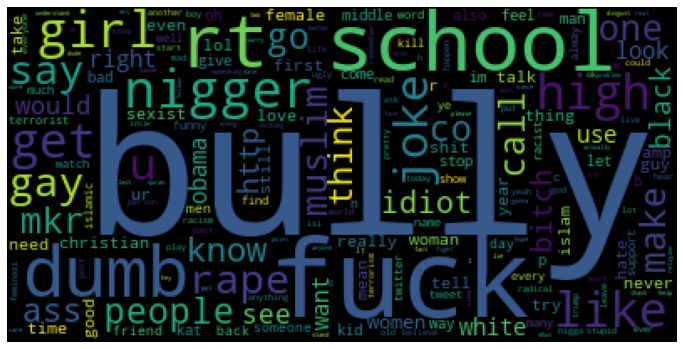

In [152]:
from nltk.corpus import stopwords
from wordcloud import WordCloud
import re

def clean_text(s):
    s = re.sub(r'http\S+', '', s)
    s = re.sub('(RT|via)((?:\\b\\W*@\\w+)+)', ' ', s)
    s = re.sub(r'@\S+', '', s)
    s = re.sub('&amp', ' ', s)
    return s
df['clean_tweet'] = df['tweettext'].apply(clean_text)

text = df['clean_tweet'].to_string().lower()    
wordcloud = WordCloud(
    collocations=False,
    relative_scaling=0.5,
    stopwords=set(stopwords.words('english'))).generate(text)

plt.figure(figsize=(12,12))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

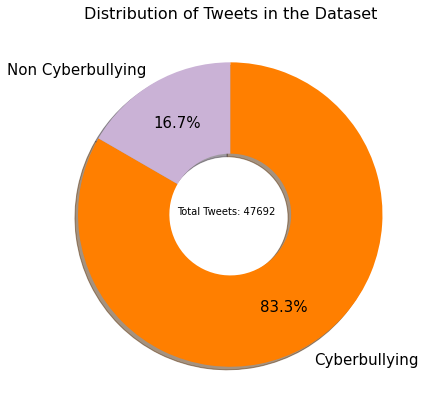

In [153]:
import seaborn as sns
df3 = pd.read_csv('newcleaneddata.csv')
plt.figure(figsize = (7,7))
sorted_counts = df3['cyberbullyingtype'].value_counts()
plt.pie(sorted_counts, labels = sorted_counts.index, startangle = 90, counterclock = False, wedgeprops = {'width' : 0.6},
       autopct='%1.1f%%', pctdistance = 0.7, textprops = {'color': 'black', 'fontsize' : 15}, shadow = True,
        colors = sns.color_palette("Paired")[7:])
plt.text(x = -0.35, y = 0, s = 'Total Tweets: {}'.format(df.shape[0]))
plt.title('Distribution of Tweets in the Dataset', fontsize = 16);


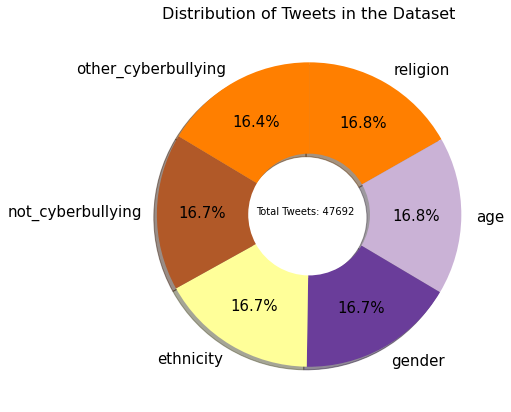

In [155]:
df4 = pd.read_csv('cyberbullying_tweets.csv')
plt.figure(figsize = (7,7))
sorted_counts = df4['cyberbullying_type'].value_counts()
plt.pie(sorted_counts, labels = sorted_counts.index, startangle = 90, counterclock = False, wedgeprops = {'width' : 0.6},
       autopct='%1.1f%%', pctdistance = 0.7, textprops = {'color': 'black', 'fontsize' : 15}, shadow = True,
        colors = sns.color_palette("Paired")[7:])
plt.text(x = -0.35, y = 0, s = 'Total Tweets: {}'.format(df.shape[0]))
plt.title('Distribution of Tweets in the Dataset', fontsize = 16);

How many most common words to print: 30
The 30 most common words are as follows

bully :  10882
school :  9173
fuck :  6766
like :  5960
joke :  5608
get :  5131
high :  5064
dumb :  4977
people :  4671
nigger :  4356
rape :  4328
say :  4149
gay :  4056
u :  4051
make :  3857
call :  3805
go :  3276
co :  3262
one :  3126
http :  3093
amp :  2958
ass :  2817
black :  2794
think :  2600
know :  2564
girl :  2472
mkr :  2470
girls :  2469
bitch :  2443
muslims :  2358


<AxesSubplot:xlabel='Word'>

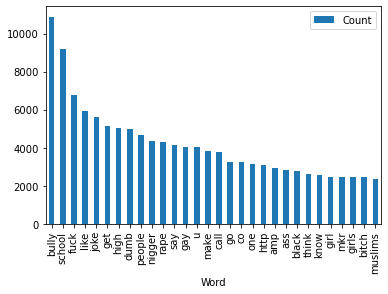

In [156]:
import collections
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
file = open('cyberbullyingtweets_1.csv', encoding="utf8")
a= file.read()
wordcount = {}
for word in a.lower().split():
        word = word.replace(".","")
        word = word.replace(",","")
        word = word.replace(":","")
        word = word.replace("\"","")
        word = word.replace("!","")
        word = word.replace("â€œ","")
        word = word.replace("â€˜","")
        word = word.replace("*","")
        if word not in wordcount:
                wordcount[word] = 1
        else:
                wordcount[word] += 1
n_print = int(input("How many most common words to print: "))
print("The {} most common words are as follows\n".format(n_print))
word_counter = collections.Counter(wordcount)
for word, count in word_counter.most_common(n_print):
    print(word, ": ", count)
file.close()
lst = word_counter.most_common(n_print)
df = pd.DataFrame(lst, columns = ['Word', 'Count'])
df.plot.bar(x='Word',y='Count')